## Problem Statement

Understanding a customer's emotions during a service call is the key towards providing a great customer experience. This requires years of practice and a keen ear. Moreover, not all customers are explicit in conveying their true emotions. But when the volume of calls increase exponentially for a company, depending on the service agent to ascertain the customer's state of mind is not a scalable solution. There needs to be a more standardised, automated experience.

The intent of this capstone is to correctly identify the emotion of a customer during a call, so that the agent can speak in an appropriate manner and provide a solution. The model used in this notebook can be part of any call center product that agents use - they can use it to accurately pinpoint the emotion and provide an appropriate response, in order to increase the NPS scores.

Moreover, this model can also be used for feedback and postmortems - did the agent's response accurately address the customer's emotional frame of mind? if the customer was happy during the call, was the agent able to cross-sell or upsell another offering? etc...


### Datasets

The model has been trained on 2 datasets :

- Surrey Audio-Visual Expressed Emotion (SAVEE) - https://www.kaggle.com/ejlok1/surrey-audiovisual-expressed-emotion-savee

- Toronto Emotional Speech Set (TESS) - https://www.kaggle.com/ejlok1/toronto-emotional-speech-set-tess

Both have been compiled with voice actors repeating certain words and phrases in 7 emotions - anger, disgust, fear, happiness, pleasant surprise, sadness, and neutral.

In [69]:
import librosa
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
from scipy.io import wavfile as wav
import os
import pandas as pd
import numpy as np
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras import optimizers
from sklearn.model_selection import train_test_split
from sklearn import ensemble
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import cross_val_score

# 1. Running ANN models separately on each dataset

Using Mel Frequency Cepstral Coefficients(MFCC) as the features, as it is best suited for audio data on deep learning models.

## 1.1 Working with the TESS dataset

In [2]:
# Loading the files from the local hard drive

dir = '/Users/hafiznadirshah/Downloads/TESS Toronto emotional speech set data'
tess_filepaths = []

for subdir, dirs, files in os.walk(dir):
    for file in files:
        tess_filepaths.append(os.path.join(subdir, file))


In [3]:
# Removing the 2 non wav files

tess_filepaths.pop(0)
tess_filepaths.pop(800)

'/Users/hafiznadirshah/Downloads/TESS Toronto emotional speech set data/TESS Toronto emotional speech set data/.DS_Store'

In [4]:
# Playing some sample audio files

ipd.Audio(tess_filepaths[13])

In [5]:
ipd.Audio(tess_filepaths[279])

In [6]:
ipd.Audio(tess_filepaths[3029])

### Extracting the MFCC features with librosa

In [7]:
X_tess = []

for filepath in tess_filepaths:
    data, sample_rate = librosa.load(filepath)
    mfccs = np.mean(librosa.feature.mfcc(data, sample_rate, n_mfcc=40).T, axis=0)
    X_tess.append(mfccs)
    
X_tess = np.asarray(X_tess)

In [8]:
X_tess.shape

(5600, 40)

### Coding the emotions according to the file names

In [9]:
emotions = []
for file in tess_filepaths:
    emotions.append(file.split('_')[-1].split('.')[0])
    
y_tess = emotions

In [10]:
y_tess = np.where(y_tess =='angry', 1, y_tess)
y_tess = np.where(y_tess =='disgust', 2, y_tess)
y_tess = np.where(y_tess =='fear', 3, y_tess)
y_tess = np.where(y_tess =='happy', 4, y_tess)
y_tess = np.where(y_tess =='neutral', 5, y_tess)
y_tess = np.where(y_tess =='ps', 6, y_tess)
y_tess = np.where(y_tess =='sad', 7, y_tess)
y_tess = np.where(y_tess =='angry', 1, y_tess)

In [11]:
# splitting into test and training data with stratify, to equally split the target variables

X_tess_train, X_tess_test, y_tess_train, y_tess_test = train_test_split(X_tess, y_tess, test_size=0.2, random_state=13, stratify=y_tess)

In [12]:
# Making the predictor and targt variables ready for ANN

X_tess_train = X_tess_train.astype('float32')
X_tess_test = X_tess_test.astype('float32')

y_tess_train = to_categorical(y_tess_train)
y_tess_test = to_categorical(y_tess_test)

In [13]:
X_tess[:20]

array([[-4.29481232e+02,  5.52394218e+01,  4.12869692e-01,
         3.57551308e+01, -6.94038868e+00, -5.86471605e+00,
        -9.47663593e+00, -1.43156195e+01, -7.51188564e+00,
        -1.03786221e+01, -8.31832790e+00,  7.63964510e+00,
        -8.65180302e+00,  2.76176286e+00, -1.79540610e+00,
        -5.11644077e+00,  3.06538820e+00, -7.64907420e-01,
        -1.06398697e+01,  3.28474092e+00, -8.88181496e+00,
         1.14587593e+00, -3.05605602e+00,  1.80502522e+00,
        -1.07795882e+00,  4.24160389e-03, -2.53696656e+00,
         3.72603726e+00, -1.39533615e+00,  6.49456787e+00,
         1.19371808e+00,  6.15623474e+00,  3.74486899e+00,
         3.87890148e+00,  4.01060009e+00,  2.78447127e+00,
         2.33695841e+00,  3.53610945e+00,  1.17151821e+00,
         2.41863370e+00],
       [-3.84011444e+02,  8.01499481e+01, -1.05837040e+01,
         1.37894993e+01, -8.19059658e+00, -1.13199348e+01,
        -1.33493214e+01, -1.08287020e+01, -1.03025398e+01,
        -1.37510204e+00, -1.20

### Creating the ANN model for the TESS data set

In [14]:
model1 = Sequential()

# adding the hidden layers
model1.add(Dense(40, activation='relu', input_shape=(40,)))
model1.add(Dense(256, activation='relu'))
model1.add(Dense(128, activation='relu'))
model1.add(Dense(64, activation='relu'))

# adding the output layer
model1.add(Dense(8, activation='softmax'))

# compiling the model
model1.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 40)                1640      
_________________________________________________________________
dense_1 (Dense)              (None, 256)               10496     
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_3 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_4 (Dense)              (None, 8)                 520       
Total params: 53,808
Trainable params: 53,808
Non-trainable params: 0
_________________________________________________________________


In [15]:
# training the model

model1.fit(X_tess_train, y_tess_train, batch_size=128, epochs=20, verbose=1)

Epoch 1/20
35/35 [==============================] - 1s 3ms/step - loss: 4.5223 - accuracy: 0.3565
Epoch 2/20
35/35 [==============================] - 0s 2ms/step - loss: 0.5378 - accuracy: 0.8346
Epoch 3/20
35/35 [==============================] - 0s 3ms/step - loss: 0.2759 - accuracy: 0.9259
Epoch 4/20
35/35 [==============================] - 0s 3ms/step - loss: 0.2035 - accuracy: 0.9424
Epoch 5/20
35/35 [==============================] - 0s 3ms/step - loss: 0.1773 - accuracy: 0.9458
Epoch 6/20
35/35 [==============================] - 0s 3ms/step - loss: 0.1563 - accuracy: 0.9538
Epoch 7/20
35/35 [==============================] - 0s 3ms/step - loss: 0.1026 - accuracy: 0.9676
Epoch 8/20
35/35 [==============================] - 0s 3ms/step - loss: 0.0844 - accuracy: 0.9737
Epoch 9/20
35/35 [==============================] - 0s 3ms/step - loss: 0.0763 - accuracy: 0.9761
Epoch 10/20
35/35 [==============================] - 0s 3ms/step - loss: 0.0573 - accuracy: 0.9828
Epoch 11/20
35/35 [

In [16]:
# getting the accuracy on test data

score = model1.evaluate(X_tess_test, y_tess_test, verbose=1)

print(f'Test score : {score[0]}')
print(f'Test accuracy : {score[1]}')

35/35 [==============================] - 0s 1ms/step - loss: 0.0210 - accuracy: 0.9920
Test score : 0.02097661979496479
Test accuracy : 0.9919642806053162


In [17]:
# Making predictions with the model

y_preds_rf1 = model1.predict(X_tess_test)
print(len(y_preds_rf1))


1120


In [18]:
# Checking the accuracy for a Random Forest model

rf = ensemble.RandomForestClassifier()
rf.fit(X_tess_train, y_tess_train)
print(f"Accuracy for Random Forest is : {rf.score(X_tess_test, y_tess_test)}")

Accuracy for Random Forest is : 0.9964285714285714


In [19]:
multilabel_confusion_matrix(y_tess_test, rf.predict(X_tess_test))

array([[[1120,    0],
        [   0,    0]],

       [[ 960,    0],
        [   2,  158]],

       [[ 960,    0],
        [   0,  160]],

       [[ 960,    0],
        [   0,  160]],

       [[ 960,    0],
        [   2,  158]],

       [[ 960,    0],
        [   0,  160]],

       [[ 960,    0],
        [   0,  160]],

       [[ 960,    0],
        [   0,  160]]])

### Conclusion from ANN on TESS dataset

Observing pretty high accuracy with an ANN as well as a Random Forest model. The false positives and false negatives are do not have outliers amongst the 7 emotions.

## 1.2 Working with the SAVEE dataset

In [20]:
# extracting the files from the local hard drive

dir = "/Users/hafiznadirshah/Downloads/ALL"
filenames = []

for filename in os.listdir(dir):
    filenames.append(filename)

In [21]:
filenames[:5]

['JK_sa01.wav', 'JK_sa15.wav', 'DC_n13.wav', 'DC_su09.wav', 'DC_n07.wav']

In [22]:
# Playing some sample audio files

ipd.Audio(dir+'/'+filenames[10])

In [23]:
ipd.Audio(dir+'/'+filenames[347])

In [24]:
ipd.Audio(dir+'/'+filenames[417])

In [25]:
# Creating a dataframe to store the data from the files

emotions_df = pd.DataFrame()
speaker = []
emotions = []
sample_num = []

for file in filenames:
    speaker.append(file.split('_')[0])
    emotions.append(file.split('_')[1][:-6])
    sample_num.append(file.split('_')[1][-6:-4])

In [26]:
len(speaker)

480

In [27]:
emotions_df['Filename'] = filenames
emotions_df['Speaker'] = speaker
emotions_df['Emotion'] = emotions
emotions_df['Sample Number'] = sample_num

# confirming the sample set integrity

emotions_df['Emotion'].value_counts()

n     120
f      60
a      60
sa     60
su     60
h      60
d      60
Name: Emotion, dtype: int64

In [28]:
emotions_df['Speaker'].value_counts()

DC    120
JE    120
KL    120
JK    120
Name: Speaker, dtype: int64

In [29]:
dir+'/'+filenames[10]

'/Users/hafiznadirshah/Downloads/ALL/KL_sa13.wav'

### Extracting the MFCC feautres with librosa

In [30]:
X_savee = []
for file in filenames:
    data, sample_rate = librosa.load(os.path.join(dir, file))
    mfccs = np.mean(librosa.feature.mfcc(data, sample_rate, n_mfcc=40).T, axis=0)
    X_savee.append(mfccs)

X_savee = np.asarray(X_savee)

In [31]:
X_savee.shape

(480, 40)

In [32]:
emotions_df

,Filename,Speaker,Emotion,Sample Number
0,JK_sa01.wav,JK,sa,01
1,JK_sa15.wav,JK,sa,15
2,DC_n13.wav,DC,n,13
3,DC_su09.wav,DC,su,09
4,DC_n07.wav,DC,n,07
...,...,...,...,...
475,JE_a01.wav,JE,a,01
476,JE_a15.wav,JE,a,15
477,DC_n22.wav,DC,n,22
478,DC_su04.wav,DC,su,04


In [33]:
# Changing the target variable to integer

y_savee = emotions_df['Emotion']

y_savee = np.where(y_savee =='a', 1, y_savee)
y_savee = np.where(y_savee =='d', 2, y_savee)
y_savee = np.where(y_savee =='f', 3, y_savee)
y_savee = np.where(y_savee =='h', 4, y_savee)
y_savee = np.where(y_savee =='sa', 5, y_savee)
y_savee = np.where(y_savee =='su', 6, y_savee)
y_savee = np.where(y_savee =='n', 7, y_savee)

In [34]:
# splitting into test and training data with stratify, to equally split the target variables

X_savee_train, X_savee_test, y_savee_train, y_savee_test = train_test_split(X_savee, y_savee, test_size=0.2, random_state=13, stratify=y_savee)

In [35]:
model2 = Sequential()

# adding the hidden layers
model2.add(Dense(40, activation='relu', input_shape=(40,)))
model2.add(Dense(256, activation='relu'))
model2.add(Dense(128, activation='relu'))
model2.add(Dense(64, activation='relu'))

# adding the output layer
model2.add(Dense(8, activation='softmax'))

# compiling the model
model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_6 (Dense)              (None, 256)               10496     
_________________________________________________________________
dense_7 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_8 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_9 (Dense)              (None, 8)                 520       
Total params: 53,808
Trainable params: 53,808
Non-trainable params: 0
_________________________________________________________________


In [36]:
# preparing the predictor and target variables for the ANN model

X_savee_train = X_savee_train.astype('float32')
X_savee_test = X_savee_test.astype('float32')

y_savee_train = to_categorical(y_savee_train)
y_savee_test = to_categorical(y_savee_test)

In [37]:
y_savee.shape

(480,)

In [38]:
# Training the model

model2.fit(X_savee_train, y_savee_train, batch_size=128, epochs=50, verbose=1)

Epoch 1/50
3/3 [==============================] - 1s 12ms/step - loss: 15.8328 - accuracy: 0.1094
Epoch 2/50
3/3 [==============================] - 0s 5ms/step - loss: 7.3220 - accuracy: 0.1667
Epoch 3/50
3/3 [==============================] - 0s 6ms/step - loss: 5.9642 - accuracy: 0.2344
Epoch 4/50
3/3 [==============================] - 0s 5ms/step - loss: 5.0710 - accuracy: 0.2135
Epoch 5/50
3/3 [==============================] - 0s 5ms/step - loss: 3.6659 - accuracy: 0.1875
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 2.3301 - accuracy: 0.2031
Epoch 7/50
3/3 [==============================] - 0s 5ms/step - loss: 3.0595 - accuracy: 0.2344
Epoch 8/50
3/3 [==============================] - 0s 5ms/step - loss: 2.5039 - accuracy: 0.2734
Epoch 9/50
3/3 [==============================] - 0s 6ms/step - loss: 2.0059 - accuracy: 0.2943
Epoch 10/50
3/3 [==============================] - 0s 6ms/step - loss: 2.2146 - accuracy: 0.2734
Epoch 11/50
3/3 [====================

In [39]:
# getting the accuracy on test data

score2 = model2.evaluate(X_savee_test, y_savee_test, verbose=1)

print(f'Test score : {score2[0]}')
print(f'Test accuracy : {score2[1]}')

3/3 [==============================] - 0s 2ms/step - loss: 1.3008 - accuracy: 0.4583
Test score : 1.300770878791809
Test accuracy : 0.4583333432674408


In [40]:
# Checking the accuracy for Random Forest

rf1 = ensemble.RandomForestClassifier()
rf1.fit(X_savee_train, y_savee_train)
print(f"Accuracy for Random Forest is : {rf1.score(X_savee_test, y_savee_test)}")

Accuracy for Random Forest is : 0.2604166666666667


### Conclusion from ANN on SAVEE dataset

The accuracy is quite low compared to the TESS dataset. This could be due to the low datapoints for ANN - just 480.

Will try combining the 2 datasets to see whether the performance improves.

# 2. Combining the 2 datasets

## 2.1 Combining the predictor and target variables

In [41]:
X_combo = np.concatenate((X_tess, X_savee), axis=0)
len(X_combo)

6080

In [42]:
X_combo.shape

(6080, 40)

In [43]:
y_tess = np.where(y_tess =='angry', 1, y_tess)
y_tess = np.where(y_tess =='disgust', 2, y_tess)
y_tess = np.where(y_tess =='fear', 3, y_tess)
y_tess = np.where(y_tess =='happy', 4, y_tess)
y_tess = np.where(y_tess =='neutral', 5, y_tess)
y_tess = np.where(y_tess =='ps', 6, y_tess)
y_tess = np.where(y_tess =='sad', 7, y_tess)

y_savee = np.where(y_savee =='a', 1, y_savee)
y_savee = np.where(y_savee =='d', 2, y_savee)
y_savee = np.where(y_savee =='f', 3, y_savee)
y_savee = np.where(y_savee =='h', 4, y_savee)
y_savee = np.where(y_savee =='sa', 5, y_savee)
y_savee = np.where(y_savee =='su', 6, y_savee)
y_savee = np.where(y_savee =='n', 7, y_savee)

In [44]:
# changing the target variable encoding to be uniform for both datasets

y_savee1 = y_savee.copy() # creating a temporary numpy array to reorder the emotions in SAVEE according to TESS coding

y_savee1 = np.where(y_savee1 == 5, 8, y_savee1)
y_savee1 = np.where(y_savee1 == 6, 9, y_savee1)
y_savee1 = np.where(y_savee1 == 7, 10, y_savee1)

y_savee1 = np.where(y_savee1 == 10, 5, y_savee1)
y_savee1 = np.where(y_savee1 == 9, 6, y_savee1)
y_savee1 = np.where(y_savee1 == 8, 7, y_savee1)

In [45]:
# combining the 2 target variables

y_combo = np.concatenate((y_tess, y_savee1), axis=0)

In [46]:
len(y_combo)

6080

In [47]:
# Creating a DataFrame for EDA

column_names = []
for i in range(1, 41, 1):
    column_names.append('mel'+str(i))

mfcc_df = pd.DataFrame(data=X_combo, columns=column_names)
mfcc_df['emotion'] = y_combo
mfcc_df.head(5)

,mel1,mel2,mel3,mel4,mel5,mel6,mel7,mel8,mel9,mel10,...,mel32,mel33,mel34,mel35,mel36,mel37,mel38,mel39,mel40,emotion
0,-429.481232,55.239422,0.412870,35.755131,-6.940389,-5.864716,-9.476636,-14.315619,-7.511886,-10.378622,...,6.156235,3.744869,3.878901,4.010600,2.784471,2.336958,3.536109,1.171518,2.418634,2
1,-384.011444,80.149948,-10.583704,13.789499,-8.190597,-11.319935,-13.349321,-10.828702,-10.302540,-1.375102,...,4.301706,-1.240171,-1.096627,3.434932,2.861269,3.940687,3.715577,0.349929,4.531977,2
2,-408.764221,62.523369,7.337870,16.675680,-5.102801,-8.599899,-10.250184,-13.739927,-13.212698,-3.855868,...,4.110059,-0.954214,-1.080384,2.421667,3.852354,5.840267,8.782073,6.031569,7.453549,2
3,-431.373108,49.589470,-2.651820,31.474798,-10.021777,0.837466,-12.451966,-10.266146,-6.513049,1.689942,...,5.433918,3.100262,4.729064,3.785438,2.517780,2.659073,1.909756,1.053812,0.993928,2
4,-411.516022,81.550827,12.147672,2.124956,-5.180856,-1.123034,-8.947221,-14.289355,-9.510827,0.734233,...,2.095530,1.195208,1.773524,3.963868,2.209327,3.209115,3.949495,1.928796,2.924860,2


Boxplot for emotion 1


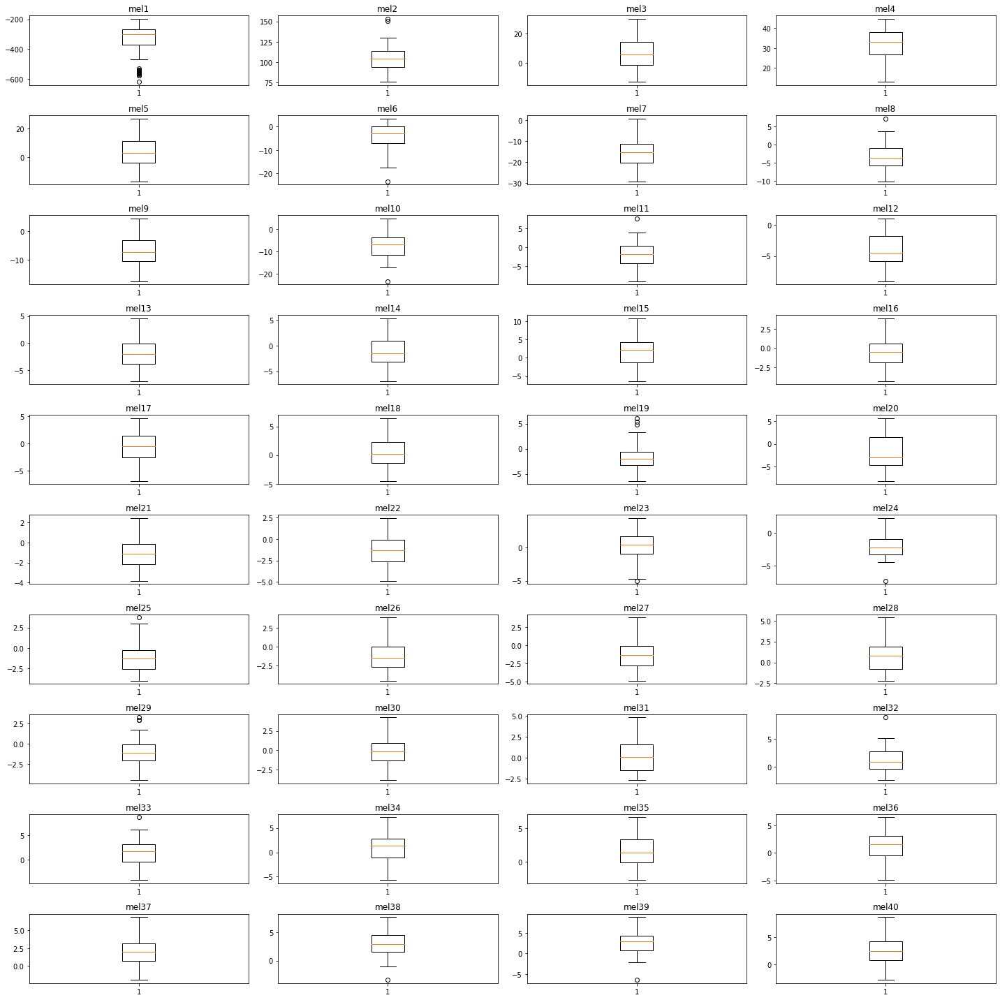




Boxplot for emotion 2


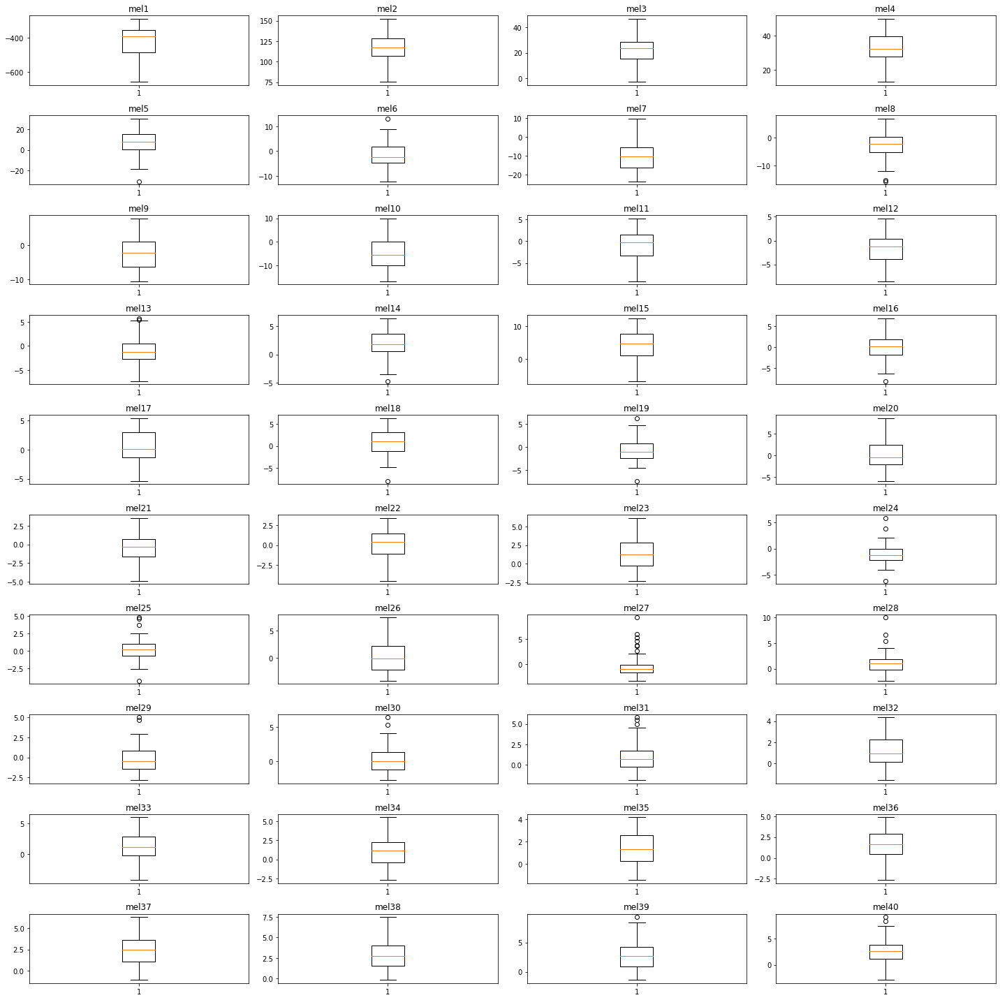




Boxplot for emotion 3


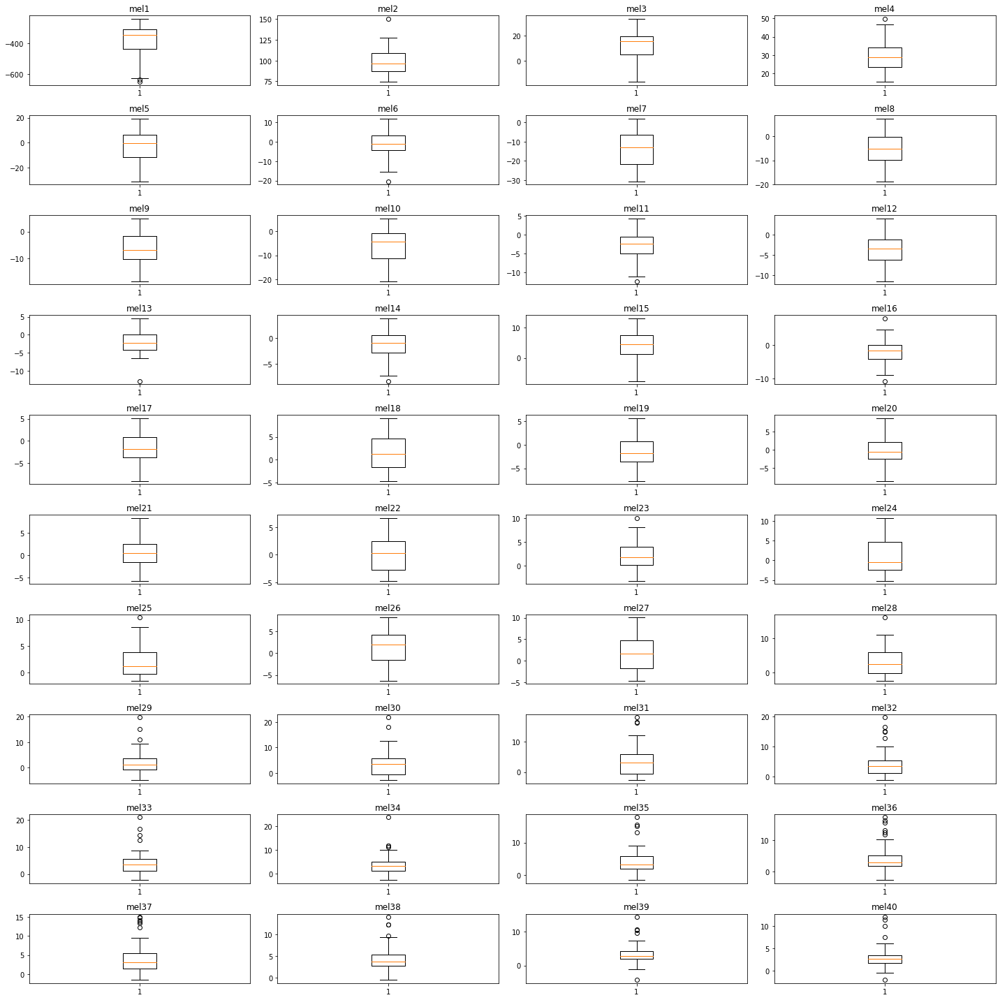




Boxplot for emotion 4


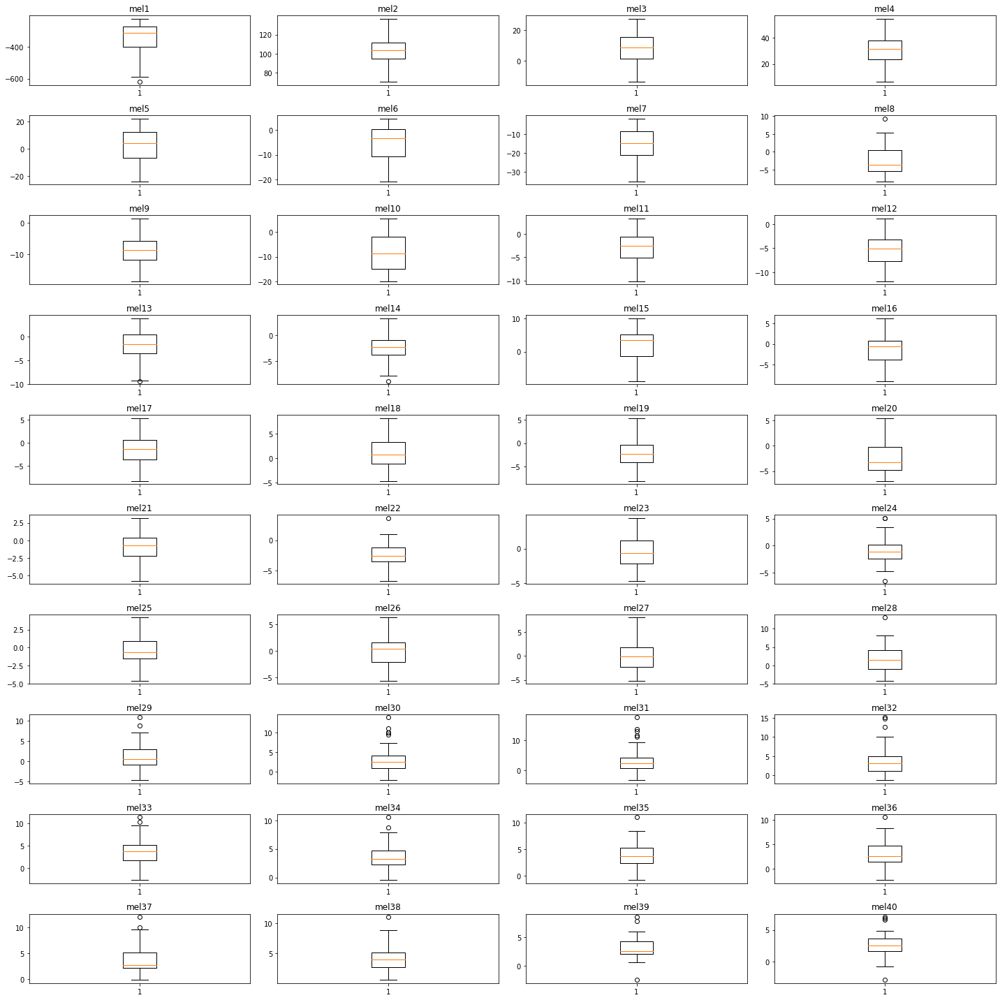




Boxplot for emotion 5


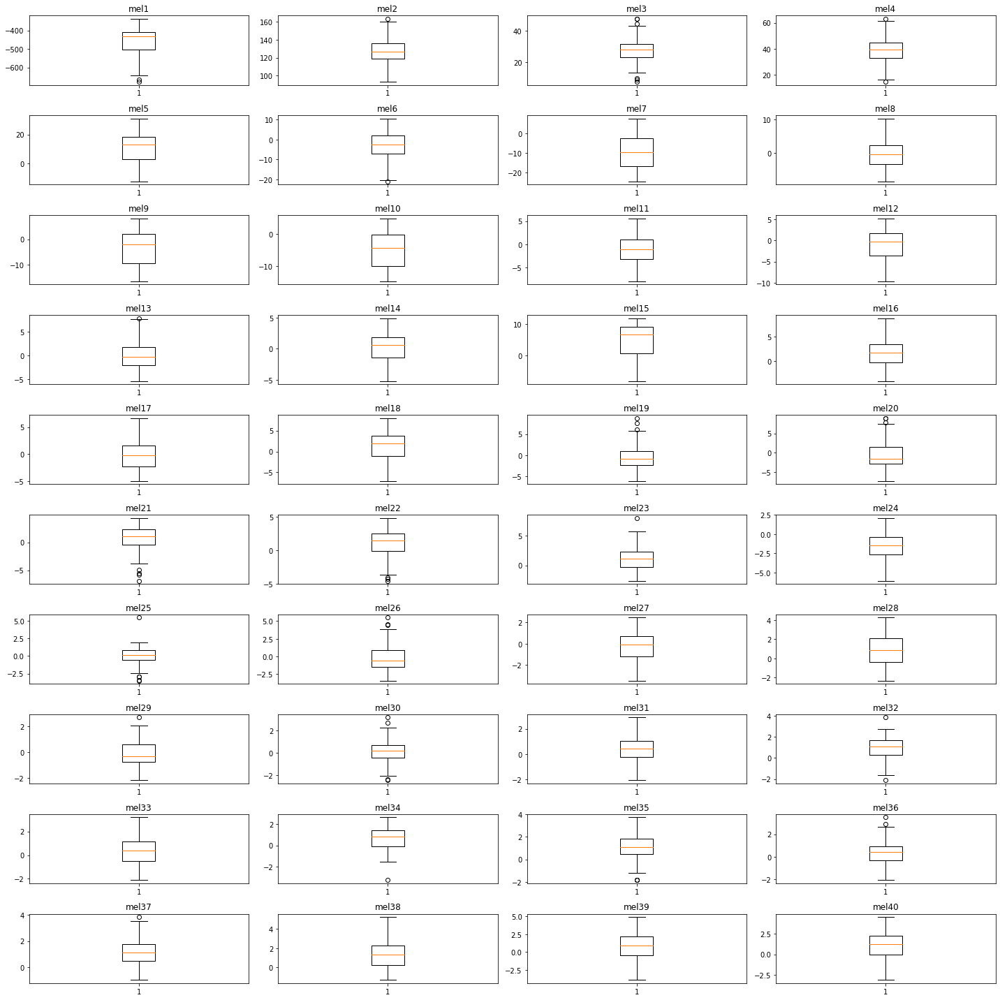




Boxplot for emotion 6


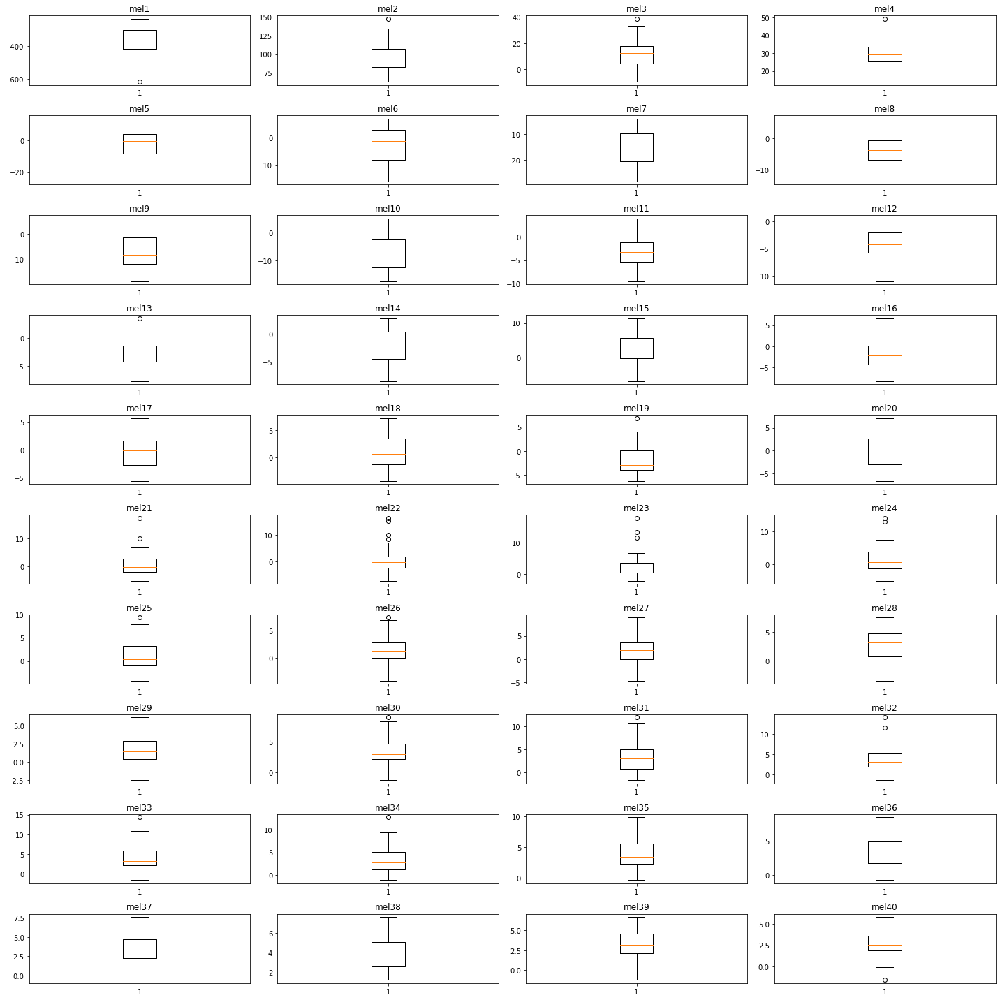




Boxplot for emotion 7


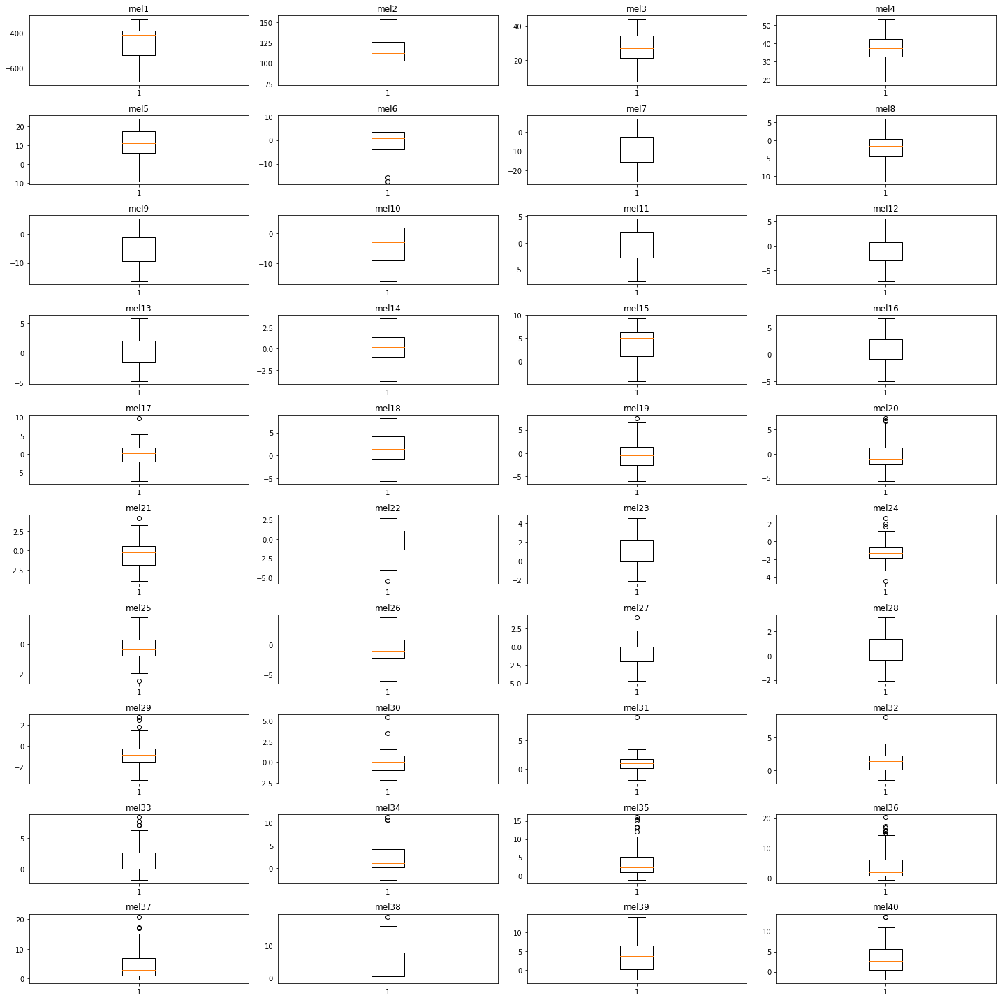

In [49]:
# Creating a boxplot for the emotion 'Angry'

for emotion in range(1,8,1):
    
    print(f'Boxplot for emotion {emotion}')
    data_df = mfcc_df[mfcc_df['emotion'] == emotion]

    plt.figure(figsize=(20,20))

    for i, mel in enumerate(data_df.columns[:-1]):
        plt.subplot(10, 4, i+1)
        plt.boxplot(data_df[mel])
        plt.tight_layout()
        plt.title(mel)

    plt.show()
    print("\n\n")

### Observations

- the outliers across all emotions are in the same mels : 1,2,3,6,10,14,18 etc
- the scale of the mels across all emotions are the same
- similarily, the difference between 25th and 75th percentile look largely the same across all emotions for a particular mel. E.g. mel 13

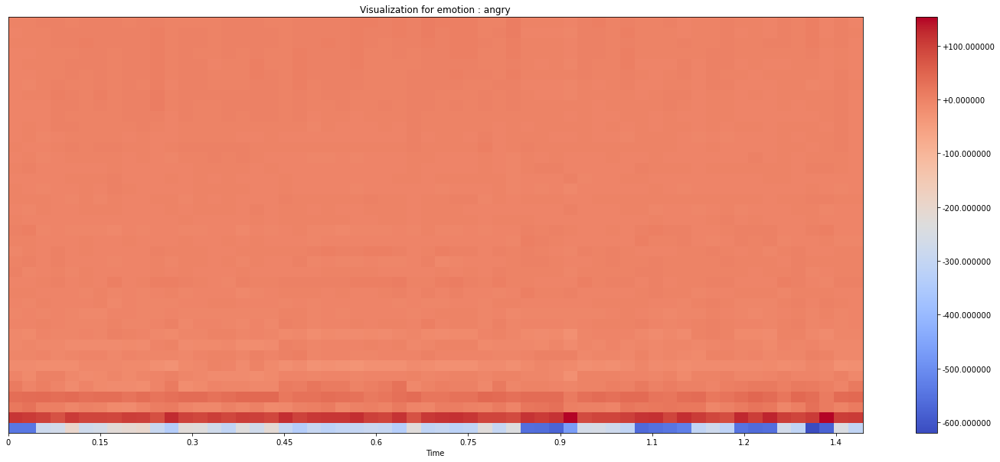

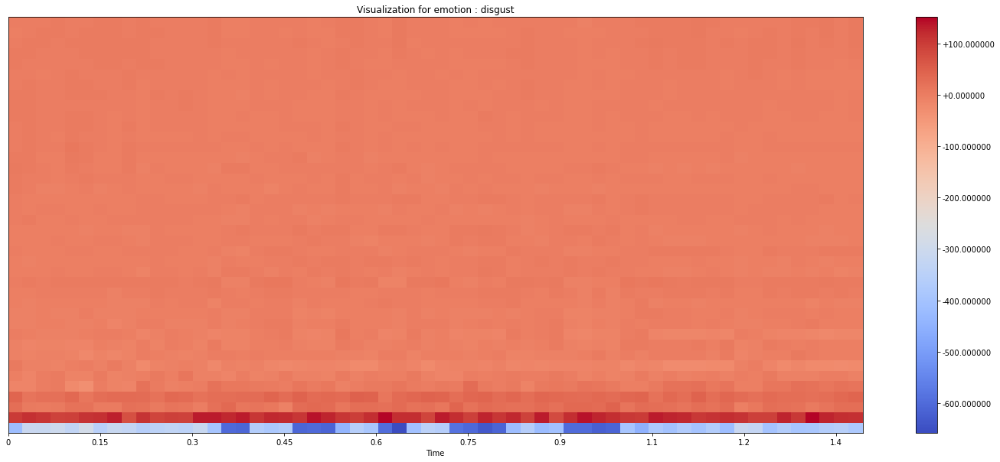

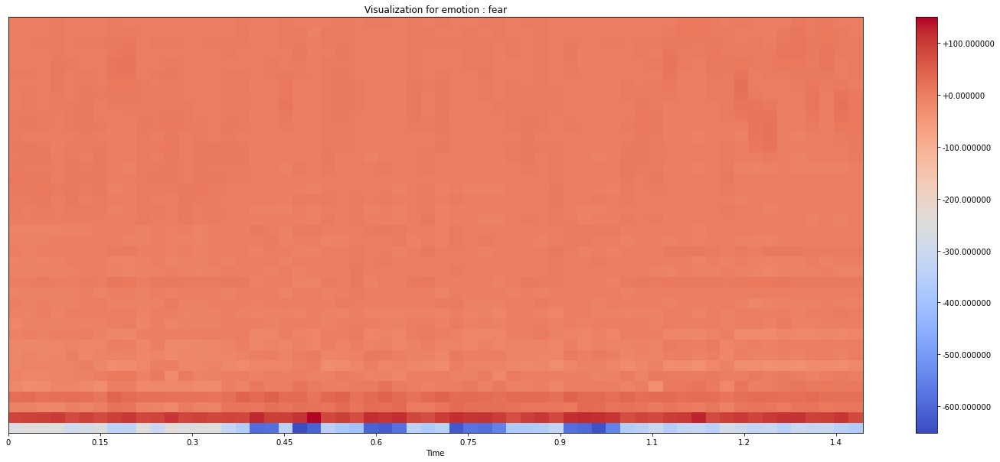

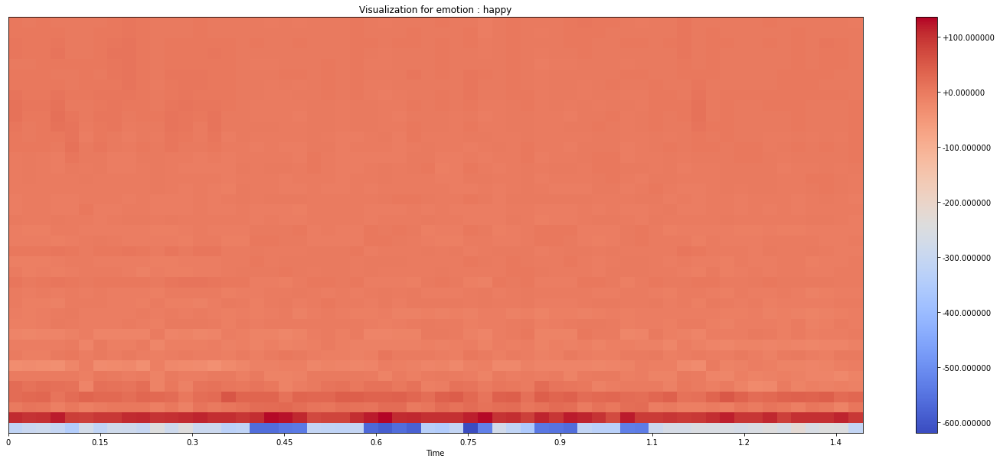

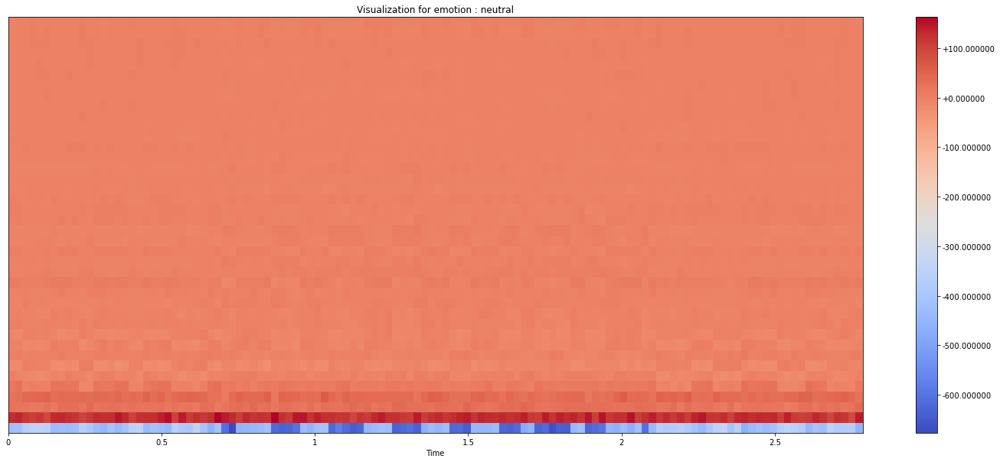

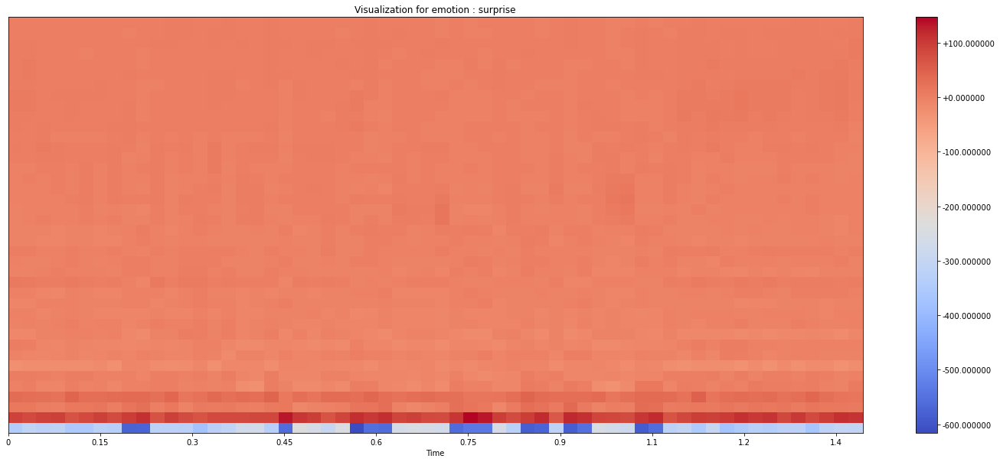

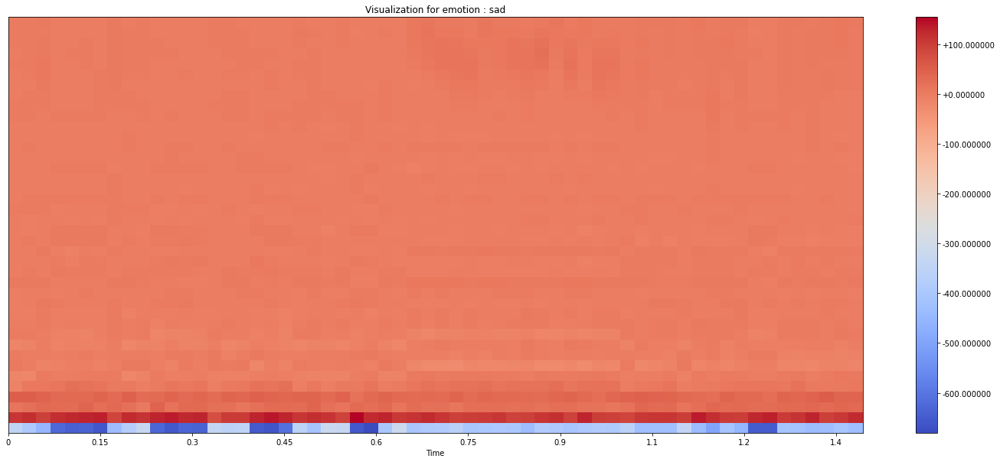

In [50]:
emotion_dict = {1:'angry',
                2:'disgust',
                3:'fear',
                4:'happy',
                5:'neutral',
                6:'surprise',
                7:'sad'
               }

for emotion in range(1,8,1):
    plt.figure(figsize=(25,10))
    plt.title(f'Visualization for emotion : {emotion_dict[emotion]}')
    emo = mfcc_df[mfcc_df['emotion'] == emotion].iloc[:, :-1].to_numpy()
    librosa.display.specshow(emo.T,
                            x_axis='time'
                            )
    plt.colorbar(format='%+2f')
    plt.show()

### Observations

- The spectrograms have plotted the 40 mels, with time on the x-axis
- There is a clear difference between the mels, especially for mel1 and mel2

## 2.2 Running an ANN model on the combined dataset

In [51]:
model3 = Sequential()

# adding the hidden layers
model3.add(Dense(40, activation='relu', input_shape=(40,)))
model3.add(Dense(256, activation='relu'))
model3.add(Dense(128, activation='relu'))
model3.add(Dense(64, activation='relu'))

# adding the output layer
model3.add(Dense(8, activation='softmax'))

# compiling the model
model3.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model3.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 40)                1640      
_________________________________________________________________
dense_11 (Dense)             (None, 256)               10496     
_________________________________________________________________
dense_12 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_13 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_14 (Dense)             (None, 8)                 520       
Total params: 53,808
Trainable params: 53,808
Non-trainable params: 0
_________________________________________________________________


In [52]:
# preparing the variables for the ANN model

X_combo = X_combo.astype('float32')
y_combo = y_combo.astype('int')

In [53]:
# splitting into training and test data

X_combo_train, X_combo_test, y_combo_train, y_combo_test = train_test_split(X_combo, y_combo, test_size=0.2, 
                                                                            random_state=13, stratify=y_combo)

In [54]:
# X_savee_train = X_savee_train.astype('float32')
# X_savee_test = X_savee_test.astype('float32')

y_combo_train = to_categorical(y_combo_train)
y_combo_test = to_categorical(y_combo_test)

In [55]:
# Training the model

model3.fit(X_combo_train, y_combo_train, batch_size=128, epochs=50, verbose=1)

Epoch 1/50
38/38 [==============================] - 1s 5ms/step - loss: 3.6799 - accuracy: 0.3403
Epoch 2/50
38/38 [==============================] - 0s 5ms/step - loss: 0.8848 - accuracy: 0.7037
Epoch 3/50
38/38 [==============================] - 0s 6ms/step - loss: 0.6428 - accuracy: 0.8024
Epoch 4/50
38/38 [==============================] - 0s 6ms/step - loss: 0.4750 - accuracy: 0.8678
Epoch 5/50
38/38 [==============================] - 0s 5ms/step - loss: 0.4568 - accuracy: 0.8623
Epoch 6/50
38/38 [==============================] - 0s 5ms/step - loss: 0.3805 - accuracy: 0.8890
Epoch 7/50
38/38 [==============================] - 0s 5ms/step - loss: 0.3050 - accuracy: 0.9167
Epoch 8/50
38/38 [==============================] - 0s 4ms/step - loss: 0.2753 - accuracy: 0.9219
Epoch 9/50
38/38 [==============================] - 0s 4ms/step - loss: 0.2381 - accuracy: 0.9330
Epoch 10/50
38/38 [==============================] - 0s 6ms/step - loss: 0.2249 - accuracy: 0.9352
Epoch 11/50
38/38 [

In [56]:
# getting the accuracy on test data

score3 = model3.evaluate(X_combo_test, y_combo_test, verbose=1)

print(f'Test score : {score3[0]}')
print(f'Test accuracy : {score3[1]}')

38/38 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9630
Test score : 0.10232720524072647
Test accuracy : 0.9629934430122375


### Combining the 2 has given a better accuracy than running the SAVEE dataset individually

## 2.3 Trying other models on the combined dataset

In [57]:
# using the single dimensional target variable from here on

X_train, X_test, y_train, y_test = train_test_split(X_combo, y_combo, test_size=0.2,
                                                   random_state=13, stratify=y_combo)

### 2.3.1 Logistic Regression

In [58]:
# Trying out Logistic Regression

from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(solver='lbfgs', penalty='none', max_iter=1000)
lr.fit(X_train, y_train)

print(f'Accuracy on training data is : {lr.score(X_train, y_train)}')
print(f'Number of iterations : {lr.n_iter_[0]}')
print(f'Accuracy on test data is : {lr.score(X_test, y_test)}')

# tuning the LR parameters

lr1 = LogisticRegression(solver='lbfgs', penalty='l2', max_iter=1000)
lr1.fit(X_train, y_train)

print(f'Accuracy on training data is : {lr1.score(X_train, y_train)}')
print(f'Number of iterations : {lr1.n_iter_[0]}')
print(f'Accuracy on test data is : {lr1.score(X_test, y_test)}')


/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy on training data is : 0.9500411184210527
Number of iterations : 1000
Accuracy on test data is : 0.946546052631579
Accuracy on training data is : 0.950452302631579
Number of iterations : 1000
Accuracy on test data is : 0.9481907894736842


/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [59]:
# Tuning the C parameter

c_vals = np.arange(0.1, 1.0, 0.1)
training_accuracy = []
test_accuracy = []

for c in c_vals:
    lr_temp = LogisticRegression(solver='lbfgs', penalty='l2', max_iter=500, C=c)
    lr_temp.fit(X_train, y_train)
    test_accuracy.append(lr_temp.score(X_test, y_test))
    training_accuracy.append(lr_temp.score(X_train, y_train))

/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_

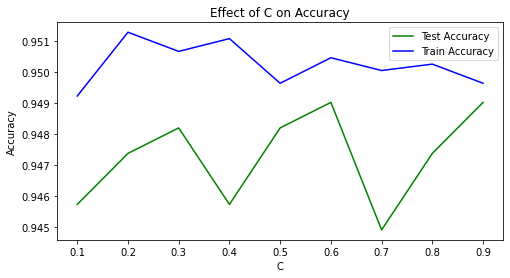

In [60]:
# plotting the accuracy for training and test data

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1, 1, 1)
ax1.plot(c_vals, test_accuracy, '-g', label='Test Accuracy')
ax1.plot(c_vals, training_accuracy, '-b', label='Train Accuracy')
ax1.set(xlabel='C', ylabel='Accuracy')
ax1.set_title('Effect of C on Accuracy')
ax1.legend()
plt.show()

#### The minimum difference between test and training accuracy is at C=0.9, and the test accuracy is also highest.

In [61]:
# Checking whether scaling the predictor variable converges the model

from sklearn.preprocessing import StandardScaler

X_scaled = StandardScaler().fit_transform(X_combo)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_combo,
                                                   test_size=0.2, random_state=13,
                                                   stratify=y_combo)

In [62]:
lr = LogisticRegression(solver='lbfgs', penalty='l2', C=0.9, max_iter=1000)
lr.fit(X_train, y_train)

print(f'Accuracy on training data is : {lr.score(X_train, y_train)}')
print(f'Number of iterations : {lr.n_iter_[0]}')
print(f'Accuracy on test data is : {lr.score(X_test, y_test)}')

Accuracy on training data is : 0.9529194078947368
Number of iterations : 149
Accuracy on test data is : 0.9432565789473685


### The model has converge with scaled variables, although there is no major difference in accuracy

### 2.3.2 Decision Tree

In [63]:
from sklearn import tree

dt = tree.DecisionTreeClassifier(criterion='gini',
                                splitter='best', min_samples_split=20)

dt.fit(X_train, y_train)
print(f'Accuracy on training data : {dt.score(X_train, y_train)}')
print(f'Accuracy on test data : {dt.score(X_test, y_test)}')

Accuracy on training data : 0.9568256578947368
Accuracy on test data : 0.9194078947368421


In [64]:
# These seems to be a certain level of overfitting
# Pruning the tree using cost complexity pruning

alphas = dt.cost_complexity_pruning_path(X_train, y_train).ccp_alphas[:-1] # discarding the highest alpha value
alphas

array([0.        , 0.00013172, 0.00013607, 0.00019011, 0.00019976,
       0.00030071, 0.00038549, 0.00038575, 0.00039062, 0.00039537,
       0.00039872, 0.00040444, 0.00040478, 0.00040556, 0.00040634,
       0.00040646, 0.00040686, 0.00040758, 0.00040779, 0.00040979,
       0.00040995, 0.00042852, 0.00057424, 0.00059578, 0.00064366,
       0.0006821 , 0.00071468, 0.00074013, 0.00074233, 0.000793  ,
       0.0007952 , 0.00079702, 0.00080014, 0.00080316, 0.00080343,
       0.00080881, 0.00081479, 0.00081899, 0.0008286 , 0.00086806,
       0.00086807, 0.00086913, 0.00093217, 0.00098485, 0.00101502,
       0.00103139, 0.00103366, 0.00103881, 0.00105222, 0.00105503,
       0.00108553, 0.00109753, 0.00110594, 0.00111393, 0.00112285,
       0.00115803, 0.00117994, 0.00119632, 0.00126693, 0.00129189,
       0.00132479, 0.00134569, 0.00140444, 0.00140923, 0.00154155,
       0.00155734, 0.00160022, 0.00162259, 0.00162355, 0.00173065,
       0.00177047, 0.00177269, 0.00184212, 0.00188318, 0.00194

In [65]:
# plotting the test and training accuracy at various alpha values

training_scores = []
test_scores = []

for alpha in alphas:
    dt_ccp = tree.DecisionTreeClassifier(criterion='gini', random_state=0, ccp_alpha=alpha)
    dt_ccp.fit(X_train, y_train)
    training_scores.append(dt_ccp.score(X_train, y_train))
    test_scores.append(dt_ccp.score(X_test, y_test))

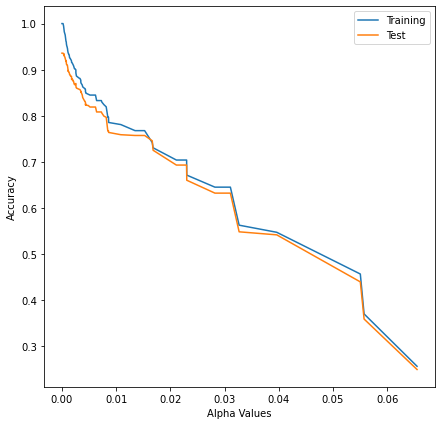

In [66]:
plt.figure(figsize=(7, 7))
plt.plot(alphas, training_scores, label='Training')
plt.plot(alphas, test_scores, label='Test')
plt.xlabel('Alpha Values')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

#### The best test accuracy is at alpha = 0.0. Thus alpha pruning won't help reduce overfitting

#### The best accuracy with Decision Tree on the test data is ~ 91%

### 2.3.3 Random Forest

In [67]:
rf = ensemble.RandomForestClassifier(criterion='gini', min_samples_split=20,
                                    max_depth=4)
rf.fit(X_train, y_train)

print(f'Accuracy on training data : {rf.score(X_train, y_train)}')
print(f'Accuracy on test data : {rf.score(X_test, y_test)}')

Accuracy on training data : 0.8824013157894737
Accuracy on test data : 0.8700657894736842


In [70]:
# trying a Random Forest without minimum samples and max_depth

rf_default = ensemble.RandomForestClassifier(criterion='gini')

rf_default.fit(X_train, y_train)

print(f'Accuracy on training data : {rf_default.score(X_train, y_train)}')
print(f'Accuracy on test data : {rf_default.score(X_test, y_test)}\n')

# trying with cross validation

cross_val_rf = cross_val_score(rf_default, X_scaled, y_combo, cv=10, scoring='accuracy')

print(f'The mean of cross validations is : {cross_val_rf.mean()}')
print(f'The std dev of cross validations is : {cross_val_rf.std()}\n')

Accuracy on training data : 1.0
Accuracy on test data : 0.975328947368421

The mean of cross validations is : 0.9424342105263157
The std dev of cross validations is : 0.17160367970358806



#### Random Forest has managed to give improve the accuracy from Decision Trees by arounf 3 percentage points

### 2.3.4 KNN Classifier

In [71]:
# Selecting the best k from cross validations

for k in np.arange(1, 15, 1):
    knn_temp = KNeighborsClassifier(n_neighbors=k, weights='distance')
    cross_val_knn = cross_val_score(knn_temp, X_scaled, y_combo, cv=10, scoring='accuracy')
    predictions = cross_val_predict(knn_temp, X_scaled, y_combo, cv=10)
    print(f"K = {k}")
    print(f'R-squared is : {r2_score(y_combo, predictions)}')
    print(f'The mean of cross validations is : {cross_val_knn.mean()}')
    print(f'The std dev of cross validations is : {cross_val_knn.std()}\n')

K = 1
R-squared is : 0.9018202927621628
The mean of cross validations is : 0.940625
The std dev of cross validations is : 0.1754009091236385

K = 2
R-squared is : 0.9018202927621628
The mean of cross validations is : 0.940625
The std dev of cross validations is : 0.1754009091236385

K = 3
R-squared is : 0.9048029674124262
The mean of cross validations is : 0.9411184210526315
The std dev of cross validations is : 0.17338022890237004

K = 4
R-squared is : 0.9033530561241037
The mean of cross validations is : 0.9409539473684211
The std dev of cross validations is : 0.1738735791068516

K = 5
R-squared is : 0.9040158727130512
The mean of cross validations is : 0.9414473684210526
The std dev of cross validations is : 0.17347600159732154

K = 6
R-squared is : 0.903601612344959
The mean of cross validations is : 0.9412828947368421
The std dev of cross validations is : 0.17396939119785834

K = 7
R-squared is : 0.9065428609584132
The mean of cross validations is : 0.9411184210526315
The std dev 

#### The best accuracy on test data across different k values is 94%

### 2.3.5 Gradient Boost Classifier

In [72]:
gbc = ensemble.GradientBoostingClassifier(n_estimators=500,
                                      max_depth=2,
                                      loss='deviance')

gbc.fit(X_train, y_train)

print(f"Accuracy on training data : {gbc.score(X_train, y_train)}")
print(f"Accuracy on test data : {gbc.score(X_test, y_test)}")



Accuracy on training data : 1.0
Accuracy on test data : 0.9588815789473685


In [73]:
# trying cross validation on Gradient Boost

cross_val_gbc = cross_val_score(gbc, X_scaled, y_combo, cv=3, scoring='accuracy')

print(f'The mean of cross validations is : {cross_val_gbc.mean()}')
print(f'The std dev of cross validations is : {cross_val_gbc.std()}')

The mean of cross validations is : 0.9299118043302549
The std dev of cross validations is : 0.09634239914113654


#### Gradient Boost has managed to return a mean of 93% accuracy with a lower standard deviation than Random Forest or KNN

# 3. Unsupervised Learning

Trying to see how well the data is classified by unsupervised models. This will be necessary in the event of unavailability of good data points, or when a wider spectrum of emotions will need to be classified.

## 3.1 Dimensionality Reduction

Currently there are 40 features. For better performance, they will need to be brought down to approximately 10 features

### 3.1.1 PCA

In [74]:
# Dimensionality Reduction with PCA

from sklearn.decomposition import PCA

X_pca = PCA(n_components=2).fit_transform(X_scaled)

In [75]:
set(y_combo)

{1, 2, 3, 4, 5, 6, 7}

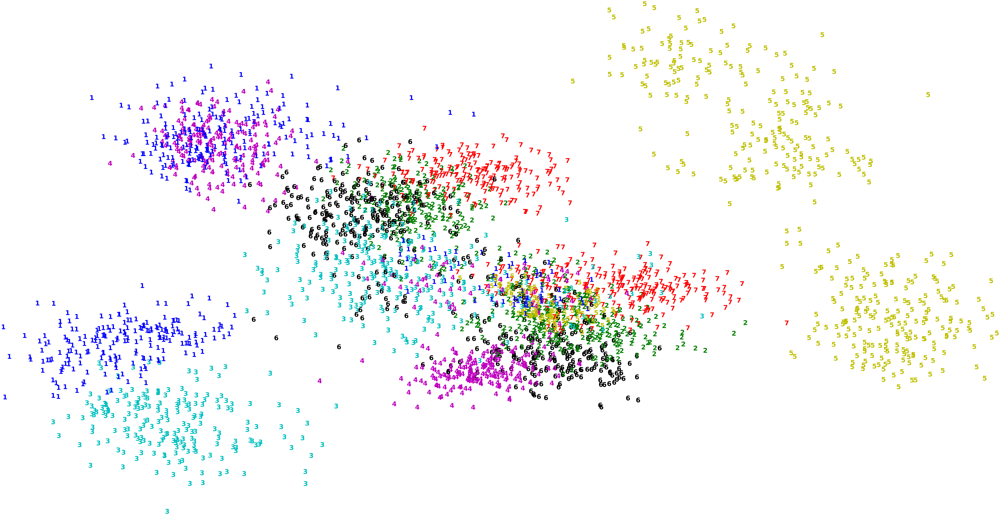

In [76]:
# Visualizing with actual labels

plt.figure(figsize=(10, 5))

colours = ["r","b","g","c","m","y","k", "r"]

for i, obs in enumerate(X_pca):
    plt.text(obs[0], obs[1], str(y_combo[i]),
            color=colours[y_combo[i]],
            fontdict={'weight': 'bold', 'size': 50}
            )
#     print(i)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

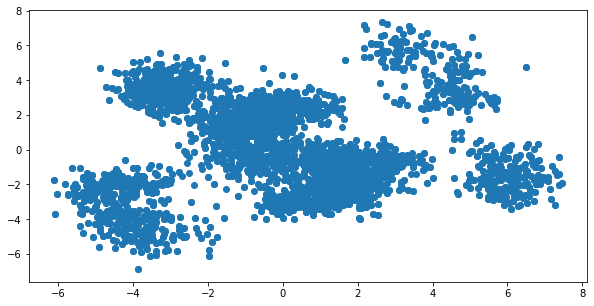

In [77]:
# Visualizing the PCA components without a target variable

plt.figure(figsize=(10,5))

plt.scatter(X_pca[:, 0], X_pca[:, 1])
plt.show()

### PCA conclusion

- PCA seems to be roughly clustering the data in to 7 clusters, which is the number of classes in the target variable

- However, we know from the labelled data visualization that there are overlaps between clusters

- Cluster number 5 is the 'neutral' emotion, and that seems to have been very well separated from the rest

### 3.1.2 t-SNE

In [78]:
# Dimensionality Reduction with t-SNE

from sklearn.manifold import TSNE
import time

start_time = time.time()

tsne = TSNE(n_components=2, perplexity=40, n_iter=350, verbose=1)
tsne_components = tsne.fit_transform(X_scaled)

print(f"Time to execute : {time.time() - start_time} seconds")

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 6080 samples in 0.001s...
[t-SNE] Computed neighbors for 6080 samples in 1.498s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6080
[t-SNE] Computed conditional probabilities for sample 2000 / 6080
[t-SNE] Computed conditional probabilities for sample 3000 / 6080
[t-SNE] Computed conditional probabilities for sample 4000 / 6080
[t-SNE] Computed conditional probabilities for sample 5000 / 6080
[t-SNE] Computed conditional probabilities for sample 6000 / 6080
[t-SNE] Computed conditional probabilities for sample 6080 / 6080
[t-SNE] Mean sigma: 1.678751
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.126137
[t-SNE] KL divergence after 350 iterations: 1.402304
Time to execute : 20.07869815826416 seconds


In [79]:
# Visualizing the t-SNE components with labeled data

plt.figure(figsize=(10, 5))

colours = ["r","b","g","c","m","y","k","r"]

for i, obs in enumerate(tsne_components):
    plt.text(obs[0], obs[1], str(y_combo[i]),
            color=colours[y_combo[i]],
            fontdict={'weight': 'bold', 'size': 50}
            )
#     print(i)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

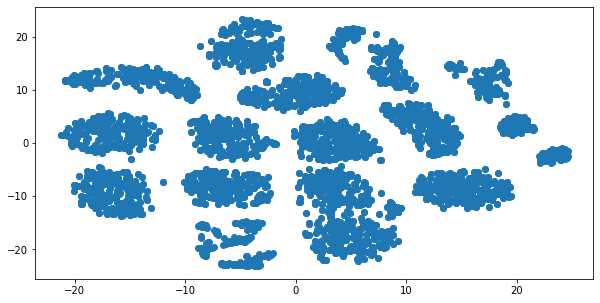

In [80]:
# Visualizing the t-SNE components without a target variable

plt.figure(figsize=(10,5))

plt.scatter(tsne_components[:, 0], tsne_components[:, 1])
plt.show()

### t-SNE conclusion

- From the labeled visualization, the individual emotions seem to be split better than PCA
- However, there seems to be way more clusters than target variable classes
- One reason could be that the 2 datasets have different voice actors, so it might be splitting on those lines in addition to the emotions clusters
- Requires further analysis

### 3.1.3 UMAP

In [81]:
# Dimensionality reduction with UMAP

import umap

start_time = time.time()

umap_model = umap.UMAP(n_neighbors=5, min_dist=0.3, 
                metric='correlation')

X_umap = umap_model.fit_transform(X_scaled)

print(f"Time to execute : {time.time() - start_time} seconds")

/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed!

Time to execute : 26.062439918518066 seconds


In [82]:
X_umap.shape

(6080, 2)

In [83]:
# Visualizing UMAP components with labeled data

plt.figure(figsize=(10, 5))

colours = ["r","b","g","c","m","y","k","r"]

for i, obs in enumerate(X_umap):
    plt.text(obs[0], obs[1], str(y_combo[i]),
            color=colours[y_combo[i]],
            fontdict={'weight': 'bold', 'size': 50}
            )
#     print(i)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

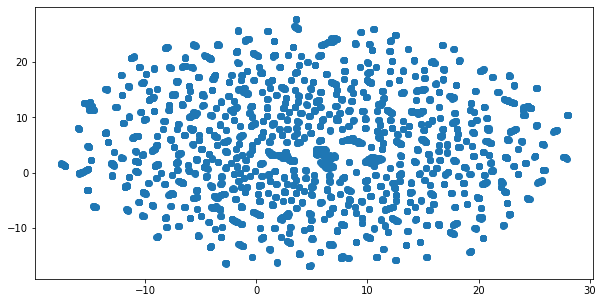

In [84]:
# Visualizing the UMAP components wihtout labeled data

plt.figure(figsize=(10,5))

plt.scatter(X_umap[:, 0], X_umap[:, 1])
plt.show()

In [85]:
# Trying UMAP on scaled data

start_time = time.time()

umap_model1 = umap.UMAP(n_neighbors=5, min_dist=0.3, 
                metric='correlation')

X_umap_combo = umap_model1.fit_transform(X_combo)

print(f"Time to execute : {time.time() - start_time} seconds")

/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed!

Time to execute : 9.381201028823853 seconds


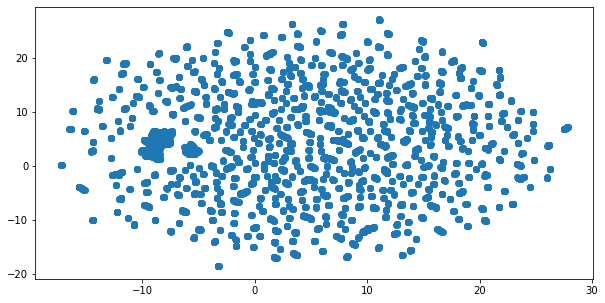

In [86]:
plt.figure(figsize=(10,5))

plt.scatter(X_umap_combo[:, 0], X_umap_combo[:, 1])
plt.show()

### UMAP conclusion

- Theorotically, UMAP is supposed to work the best for audio data
- However, it seems to have become extremely granular in terms of clustering
- Scaled variable did not perform better than unscaled variables
- Would need to hypertune and do more analysis
- In the interest of time, will be going ahead withe PCA for further analysis

## 3.2 Trying different clustering models

### 3.2.1 KMeans Clustering

In [87]:
# Reducing the dataset to 10 PCA components

X_pca_10 = PCA(n_components=10).fit_transform(X_scaled)

# building a KMeans model

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans

kmeans = KMeans(n_clusters=7, random_state=13)
kmeans.fit(X_pca_10)

kmeans_preds = kmeans.predict(X_pca_10)

In [88]:
set(kmeans_preds)

{0, 1, 2, 3, 4, 5, 6}

In [89]:
# Creating a dataframe of features and predictions

results_df = pd.DataFrame()

for i in range(10):
    feature = 'pca ' + str(i+1)
    results_df[feature] = X_pca_10[:,i]

In [90]:
results_df.head()

,pca 1,pca 2,pca 3,pca 4,pca 5,pca 6,pca 7,pca 8,pca 9,pca 10
0,-0.681743,2.951053,-0.048725,1.501375,0.637231,-0.024029,0.488586,-0.631257,0.008939,0.967016
1,-0.897036,0.903410,0.697273,1.009894,-0.584244,0.171409,2.123665,0.147536,-1.413710,1.512829
2,0.290253,1.255066,0.674860,1.452031,-0.289339,-0.618095,0.471461,-0.223443,-1.038469,0.808742
3,-0.611249,1.939719,0.499896,0.808096,-0.035389,0.611238,0.489213,1.000279,0.925712,0.549368
4,0.151369,-0.046557,0.024919,1.033618,0.381081,0.239917,0.924733,0.357441,-0.596177,-0.035791


In [91]:
results_df['actual preds'] = y_combo

In [92]:
results_df['kmeans preds'] = kmeans_preds

In [93]:
from sklearn.metrics import rand_score

# checking the Rand score
rand_score(results_df['actual preds'], results_df['kmeans preds'])

0.7899068514558315

In [94]:
from sklearn import metrics

# Checking the adjusted rand score and silhouette score
print(metrics.adjusted_rand_score(results_df['actual preds'], results_df['kmeans preds']))

print(metrics.silhouette_score(X_pca_10, results_df['kmeans preds'], metric='euclidean'))

0.2523303250284642
0.3017109


In [138]:
# Trying out elbow method for kmeans

inertias = []
silhouettes = []
for i in range(2, 12, 1):
    kmeans_temp = KMeans(n_clusters=i)
    preds_temp = kmeans_temp.fit_predict(X_pca_10)
    silhouettes.append(metrics.silhouette_score(X_pca_10, preds_temp, metric='euclidean'))
    inertias.append(kmeans_temp.inertia_)

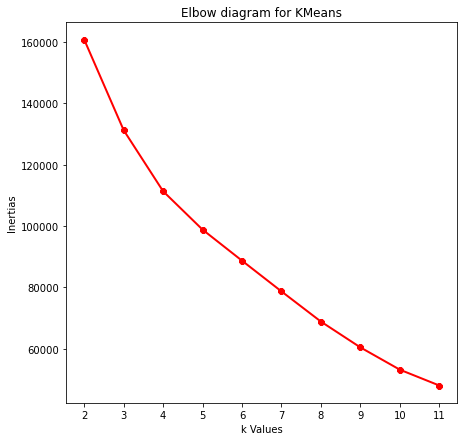

In [139]:
plt.figure(figsize=(7, 7))
plt.plot(range(2, 12, 1), inertias, linewidth=2, color="red", marker ="8")
plt.xticks(np.arange(2,12,1))
plt.title('Elbow diagram for KMeans')
plt.xlabel('k Values')
plt.ylabel('Inertias')
plt.show()

In [140]:
# Silhouette scores for each k

for i, silhouette_score in enumerate(silhouettes):
    print(f"The silhouette score for k = {i+2} is : {silhouette_score}")

The silhouette score for k = 2 is : 0.19311048090457916
The silhouette score for k = 3 is : 0.25368332862854004
The silhouette score for k = 4 is : 0.27274733781814575
The silhouette score for k = 5 is : 0.2933867275714874
The silhouette score for k = 6 is : 0.28189748525619507
The silhouette score for k = 7 is : 0.3031611144542694
The silhouette score for k = 8 is : 0.34209468960762024
The silhouette score for k = 9 is : 0.3461247384548187
The silhouette score for k = 10 is : 0.3660253882408142
The silhouette score for k = 11 is : 0.38594016432762146


### Going by the elbow method, k=4 seems to be the optimum number of clusters

In [133]:
# Doing a visualization for 2-component PCA

kmeans1 = KMeans(n_clusters=7, random_state=13)
kmeans1.fit(X_pca)

kmeans_preds1 = kmeans1.predict(X_pca)

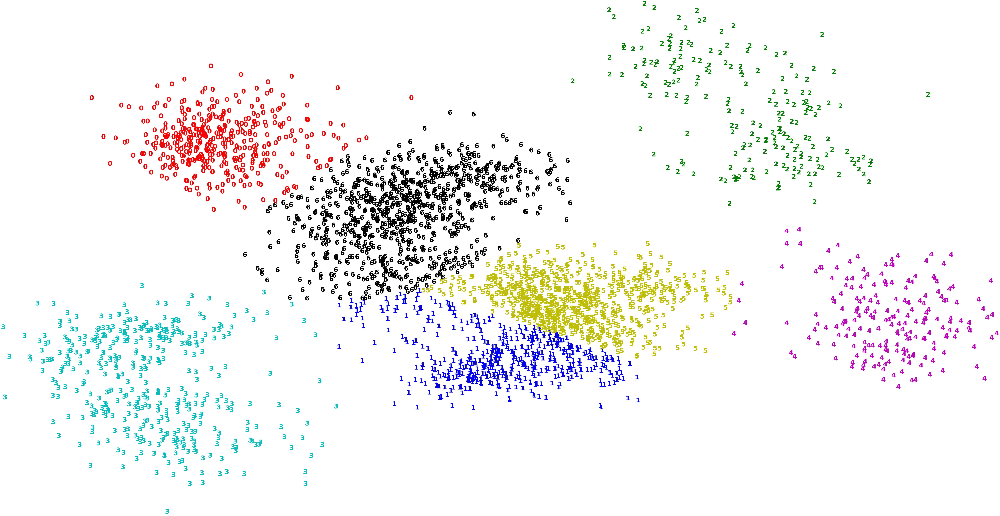

In [141]:
plt.figure(figsize=(10, 5))

colours = ["r","b","g","c","m","y","k", "r"]

for i, obs in enumerate(X_pca):
    plt.text(obs[0], obs[1], str(kmeans_preds1[i]),
            color=colours[kmeans_preds1[i]],
            fontdict={'weight': 'bold', 'size': 50}
            )
    
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### 3.2.2 Heirarchical Clustering

In [95]:
from sklearn.cluster import AgglomerativeClustering

# building the model
heirarchical = AgglomerativeClustering(linkage='complete',
                                      affinity='cosine',
                                      n_clusters=7)

heirarchical_preds = heirarchical.fit_predict(X_pca_10)

In [96]:
# adding the predictions to the DataFrame

results_df['heirarchical preds'] = heirarchical_preds

In [97]:
# checking the adjusted Rand Score and Silhouette Score

print(metrics.adjusted_rand_score(results_df['actual preds'], results_df['heirarchical preds']))

print(metrics.silhouette_score(X_pca_10, results_df['heirarchical preds'], metric='euclidean'))

0.29061071789480064
0.28573838


In [98]:
# tuning the model with 'ward' and 'euclidean' as hyperparameters

heirarchical1 = AgglomerativeClustering(linkage='ward',
                                      affinity='euclidean',
                                      n_clusters=7)

heirarchical_preds1 = heirarchical1.fit_predict(X_pca_10)

print(metrics.adjusted_rand_score(results_df['actual preds'], heirarchical_preds1))
print(metrics.silhouette_score(X_pca_10, heirarchical_preds1, metric='euclidean'))

0.2767297776895713
0.30834872


### Tuning the hyperparameters has improved the performance of the heirarchical model

### 3.2.3 Gaussian Mixture Model

In [99]:
from sklearn.mixture import GaussianMixture

# building the model
gmm = GaussianMixture(n_components=7, random_state=123)
gmm_preds = gmm.fit_predict(X_pca_10)

# adding the predictions to the DataFrame
results_df['gmm preds'] = gmm_preds

# getting the adjusted Rand Score and Silhouette Score
print(metrics.adjusted_rand_score(results_df['actual preds'], gmm_preds))
print(metrics.silhouette_score(X_pca_10, gmm_preds, metric='euclidean'))

0.308685189027921
0.29391003


### Comparing the model performances

In [100]:
results_df

,pca 1,pca 2,pca 3,pca 4,pca 5,pca 6,pca 7,pca 8,pca 9,pca 10,actual preds,kmeans preds,heirarchical preds,gmm preds
0,-0.681743,2.951053,-0.048725,1.501375,0.637231,-0.024029,0.488586,-0.631257,0.008939,0.967016,2,1,0,3
1,-0.897036,0.903410,0.697273,1.009894,-0.584244,0.171409,2.123665,0.147536,-1.413710,1.512829,2,1,0,3
2,0.290253,1.255066,0.674860,1.452031,-0.289339,-0.618095,0.471461,-0.223443,-1.038469,0.808742,2,1,0,3
3,-0.611249,1.939719,0.499896,0.808096,-0.035389,0.611238,0.489213,1.000279,0.925712,0.549368,2,1,0,3
4,0.151369,-0.046557,0.024919,1.033618,0.381081,0.239917,0.924733,0.357441,-0.596177,-0.035791,2,1,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6075,0.104024,0.040767,-1.090577,2.658025,0.557249,1.465526,2.813105,0.604163,0.602246,1.007251,1,1,3,3
6076,0.795838,-0.038038,0.540749,4.192544,2.197607,1.008587,2.694976,0.378448,1.209718,0.659161,1,1,3,3
6077,1.572886,-1.630571,-0.825628,4.098090,1.940278,0.486781,1.749546,0.164417,1.661634,0.825514,5,1,3,3
6078,0.079491,1.068317,-3.069186,2.290480,1.217206,2.361885,1.194775,-1.264635,0.749135,1.799005,6,1,3,3


In [101]:
# actual vs KMeans

multilabel_confusion_matrix(results_df['actual preds'], results_df['kmeans preds'])

array([[[5679,  401],
        [   0,    0]],

       [[4093, 1127],
        [ 800,   60]],

       [[3822, 1398],
        [ 460,  400]],

       [[4620,  600],
        [ 860,    0]],

       [[4328,  892],
        [ 460,  400]],

       [[4794,  366],
        [ 920,    0]],

       [[4784,  436],
        [ 860,    0]],

       [[5220,    0],
        [ 860,    0]]])

In [102]:
# actual vs Heirarchical

multilabel_confusion_matrix(results_df['actual preds'], results_df['heirarchical preds'])

array([[[4916, 1164],
        [   0,    0]],

       [[4820,  400],
        [ 460,  400]],

       [[4022, 1198],
        [ 844,   16]],

       [[4776,  444],
        [ 800,   60]],

       [[4420,  800],
        [ 860,    0]],

       [[4762,  398],
        [ 920,    0]],

       [[4420,  800],
        [ 460,  400]],

       [[5220,    0],
        [ 860,    0]]])

In [103]:
# actual vs GMM

multilabel_confusion_matrix(results_df['actual preds'], results_df['gmm preds'])

array([[[5280,  800],
        [   0,    0]],

       [[4820,  400],
        [ 460,  400]],

       [[4820,  400],
        [ 860,    0]],

       [[4003, 1217],
        [ 799,   61]],

       [[4819,  401],
        [ 860,    0]],

       [[3960, 1200],
        [ 920,    0]],

       [[4419,  801],
        [ 460,  400]],

       [[5220,    0],
        [ 860,    0]]])

### Unsupervised Models Conclusion

- Out of all 3 unsupervised learning models, GMM has the best adjusted rand score, and Heirarchical clustering has marginally the better silhouette score
- Unsupervised models can be used to label new emotions to a certain level of accuracy. However for better performance, it looks like more data points will be required.

## Next Steps and Optimizations

- Real-time and varying emotions : Effectiveness of the model has been proven over short phrases. Extending this for actual conversations and varying emotions will be the next step to making this more useful
- Try with different features : although MFCC has been proven to be the best for deep learning, need to try time domain and frequency domain features as well. However, due to the varying speech lengths, this would require some kind of filling in dummy data to standardize the feature lengths


## 4. Extracting some Time Domain features

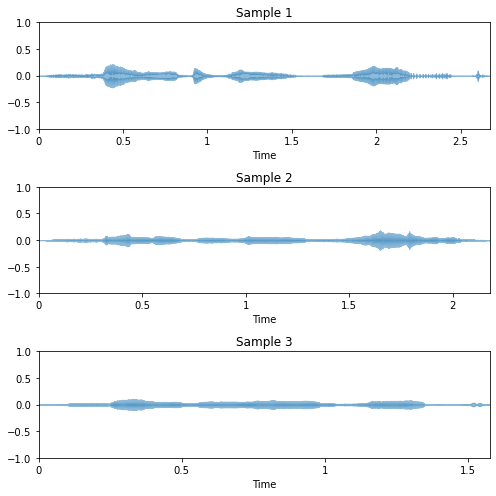

In [104]:
# Visualizing the waveplot for some of the files

sample1, _ = librosa.load(tess_filepaths[91])
sample2, _ = librosa.load(tess_filepaths[1043])
sample3, _ = librosa.load(tess_filepaths[2051])

plt.figure(figsize=(7, 7))

plt.subplot(3,1,1)
librosa.display.waveplot(sample1, alpha=0.5)
# plt.plot(t, rms_violin, color='r')
plt.ylim(-1,1)
plt.title("Sample 1")

plt.subplot(3,1,2)
librosa.display.waveplot(sample2, alpha=0.5)
plt.ylim(-1,1)
plt.title("Sample 2")

plt.subplot(3,1,3)
librosa.display.waveplot(sample3, alpha=0.5)
# plt.plot(t, rms_piano, color='r')
plt.ylim(-1,1)
plt.title("Sample 3")


plt.tight_layout()
plt.show()

In [105]:
FRAME_LENGTH = 1024
HOP_LENGTH = 512

rms_sample1 = librosa.feature.rms(sample1, frame_length = FRAME_LENGTH,
                                 hop_length=HOP_LENGTH)
rms_sample2 = librosa.feature.rms(sample2, frame_length = FRAME_LENGTH,
                                 hop_length=HOP_LENGTH)

In [106]:
print(rms_sample1.shape)
print(rms_sample2.shape)

(1, 116)
(1, 94)


In [107]:
X_rms = []
FRAME_LENGTH = 1024
HOP_LENGTH = 512

for filepath in tess_filepaths:
    audio_data, _ = librosa.load(filepath)
    rms = librosa.feature.rms(audio_data, frame_length = FRAME_LENGTH,
                                 hop_length=HOP_LENGTH)
    X_rms.append(rms)

In [108]:
X_rms

[array([[0.00052595, 0.00256811, 0.00614761, 0.00868326, 0.00957014,
         0.0113575 , 0.01215813, 0.01087106, 0.01135447, 0.01297232,
         0.01353096, 0.03120268, 0.04580932, 0.05258249, 0.05443437,
         0.0495456 , 0.04145205, 0.03509624, 0.03053265, 0.02517932,
         0.02430698, 0.02599589, 0.02337068, 0.01898743, 0.01980437,
         0.02446679, 0.02428342, 0.01747187, 0.01232697, 0.02266507,
         0.04397773, 0.04530165, 0.02762876, 0.01651382, 0.00985787,
         0.0065147 , 0.00445413, 0.0062115 , 0.01475668, 0.02414493,
         0.03092518, 0.0363466 , 0.03399226, 0.02741878, 0.02526627,
         0.02264055, 0.02020852, 0.01710784, 0.01400058, 0.01149229,
         0.0092431 , 0.0079198 , 0.00570417, 0.00267135, 0.0015725 ,
         0.0004415 , 0.00021917, 0.00014856, 0.00024309, 0.00053434,
         0.00057255, 0.00032063, 0.00022466, 0.00023732, 0.00540799,
         0.00994118, 0.02007806, 0.02792218, 0.029792  , 0.02730474,
         0.02489701, 0.02692387, 0

In [109]:
for x in X_rms:
    print(x)

[[0.00052595 0.00256811 0.00614761 0.00868326 0.00957014 0.0113575
  0.01215813 0.01087106 0.01135447 0.01297232 0.01353096 0.03120268
  0.04580932 0.05258249 0.05443437 0.0495456  0.04145205 0.03509624
  0.03053265 0.02517932 0.02430698 0.02599589 0.02337068 0.01898743
  0.01980437 0.02446679 0.02428342 0.01747187 0.01232697 0.02266507
  0.04397773 0.04530165 0.02762876 0.01651382 0.00985787 0.0065147
  0.00445413 0.0062115  0.01475668 0.02414493 0.03092518 0.0363466
  0.03399226 0.02741878 0.02526627 0.02264055 0.02020852 0.01710784
  0.01400058 0.01149229 0.0092431  0.0079198  0.00570417 0.00267135
  0.0015725  0.0004415  0.00021917 0.00014856 0.00024309 0.00053434
  0.00057255 0.00032063 0.00022466 0.00023732 0.00540799 0.00994118
  0.02007806 0.02792218 0.029792   0.02730474 0.02489701 0.02692387
  0.0286795  0.02908801 0.02942854 0.02897256 0.02445826 0.01898552
  0.01553518 0.01189823 0.00981275 0.00641467 0.00486699 0.00406701
  0.00473838 0.00560822 0.00454301 0.00244969 0.001

## 5. Training with the TESS dataset and testing on SAVEE

In [120]:
# Making copies of the original datasets

X_tess_1 = X_tess.copy()
y_tess_1 = y_tess.copy()
X_tess_1 = X_tess_1.astype('float32')
y_tess_1 = to_categorical(y_tess_1)

X_savee_1 = X_savee.copy()
y_savee_1 = y_savee.copy()
X_savee_1 = X_savee_1.astype('float32')
y_savee_1 = to_categorical(y_savee_1)

In [121]:
model4 = Sequential()

# adding the hidden layers
model4.add(Dense(40, activation='relu', input_shape=(40,)))
model4.add(Dense(256, activation='relu'))
model4.add(Dense(128, activation='relu'))
model4.add(Dense(64, activation='relu'))

# adding the output layer
model4.add(Dense(8, activation='softmax'))

# compiling the model
model4.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model4.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_20 (Dense)             (None, 40)                1640      
_________________________________________________________________
dense_21 (Dense)             (None, 256)               10496     
_________________________________________________________________
dense_22 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_23 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_24 (Dense)             (None, 8)                 520       
Total params: 53,808
Trainable params: 53,808
Non-trainable params: 0
_________________________________________________________________


In [122]:
# fitting the model

model4.fit(X_tess_1, y_tess_1, batch_size=128, epochs=20, verbose=1)

Epoch 1/20
44/44 [==============================] - 1s 3ms/step - loss: 3.0791 - accuracy: 0.4220
Epoch 2/20
44/44 [==============================] - 0s 3ms/step - loss: 0.5779 - accuracy: 0.8268
Epoch 3/20
44/44 [==============================] - 0s 3ms/step - loss: 0.3270 - accuracy: 0.9204
Epoch 4/20
44/44 [==============================] - 0s 3ms/step - loss: 0.2269 - accuracy: 0.9362
Epoch 5/20
44/44 [==============================] - 0s 5ms/step - loss: 0.1541 - accuracy: 0.9600
Epoch 6/20
44/44 [==============================] - 0s 4ms/step - loss: 0.0913 - accuracy: 0.9809
Epoch 7/20
44/44 [==============================] - 0s 3ms/step - loss: 0.0721 - accuracy: 0.9836
Epoch 8/20
44/44 [==============================] - 0s 3ms/step - loss: 0.0731 - accuracy: 0.9795
Epoch 9/20
44/44 [==============================] - 0s 4ms/step - loss: 0.0771 - accuracy: 0.9752
Epoch 10/20
44/44 [==============================] - 0s 4ms/step - loss: 0.0490 - accuracy: 0.9862
Epoch 11/20
44/44 [

In [123]:
score4 = model4.evaluate(X_savee_1, y_savee_1, verbose=1)

print(f'Test score : {score4[0]}')
print(f'Test accuracy : {score4[1]}')

15/15 [==============================] - 0s 2ms/step - loss: 8.5481 - accuracy: 0.1688
Test score : 8.548068046569824
Test accuracy : 0.16875000298023224


In [124]:
# Training with SAVEE and testing on TESS

model5 = Sequential()

# adding the hidden layers
model5.add(Dense(40, activation='relu', input_shape=(40,)))
model5.add(Dense(256, activation='relu'))
model5.add(Dense(128, activation='relu'))
model5.add(Dense(64, activation='relu'))

# adding the output layer
model5.add(Dense(8, activation='softmax'))

# compiling the model
model5.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model5.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_25 (Dense)             (None, 40)                1640      
_________________________________________________________________
dense_26 (Dense)             (None, 256)               10496     
_________________________________________________________________
dense_27 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_28 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_29 (Dense)             (None, 8)                 520       
Total params: 53,808
Trainable params: 53,808
Non-trainable params: 0
_________________________________________________________________


In [125]:
model5.fit(X_savee_1, y_savee_1, batch_size=128, epochs=20, verbose=1)

Epoch 1/20
4/4 [==============================] - 1s 4ms/step - loss: 16.9662 - accuracy: 0.1354
Epoch 2/20
4/4 [==============================] - 0s 4ms/step - loss: 7.9353 - accuracy: 0.1750
Epoch 3/20
4/4 [==============================] - 0s 3ms/step - loss: 4.4883 - accuracy: 0.2062
Epoch 4/20
4/4 [==============================] - 0s 3ms/step - loss: 3.7838 - accuracy: 0.1542
Epoch 5/20
4/4 [==============================] - 0s 3ms/step - loss: 2.3455 - accuracy: 0.2646
Epoch 6/20
4/4 [==============================] - 0s 3ms/step - loss: 2.3193 - accuracy: 0.2562
Epoch 7/20
4/4 [==============================] - 0s 3ms/step - loss: 1.9729 - accuracy: 0.3604
Epoch 8/20
4/4 [==============================] - 0s 3ms/step - loss: 1.7278 - accuracy: 0.3396
Epoch 9/20
4/4 [==============================] - 0s 4ms/step - loss: 1.6888 - accuracy: 0.3667
Epoch 10/20
4/4 [==============================] - 0s 4ms/step - loss: 1.5784 - accuracy: 0.4000
Epoch 11/20
4/4 [=====================

In [126]:
score5 = model5.evaluate(X_tess_1, y_tess_1, verbose=1)

print(f'Test score : {score5[0]}')
print(f'Test accuracy : {score5[1]}')

175/175 [==============================] - 0s 1ms/step - loss: 3.7200 - accuracy: 0.1589
Test score : 3.7200069427490234
Test accuracy : 0.15892857313156128


In [132]:
np.unique(y_combo, return_counts=True)

(array([1, 2, 3, 4, 5, 6, 7]), array([860, 860, 860, 860, 920, 860, 860]))